## Physics 5300 Final Project - Lily Y.

### Modeling motion at Lagrange points

**Background:**

**Lagrange points** describe the points in a system of one body orbiting another in which the gravity from the two objects balance, leaving a net gravitational force of zero on any objects at a Lagrange point. This makes Lagrange points ideal places for extraterrestrial observatories, such as the Nancy Grace Roman Space Telescope (planned to be deployed to the Sun-Earth L2 point) and the Solar and Heliospheric Observatory (SOHO), which is currently in halo orbit at the Sun-Earth L1 point.

Two body orbital systems in which one body orbits a much more massive body have five Lagrange points. The goal of this project is to model the motion of (hopefully) all five points as the smaller body orbits the larger one.

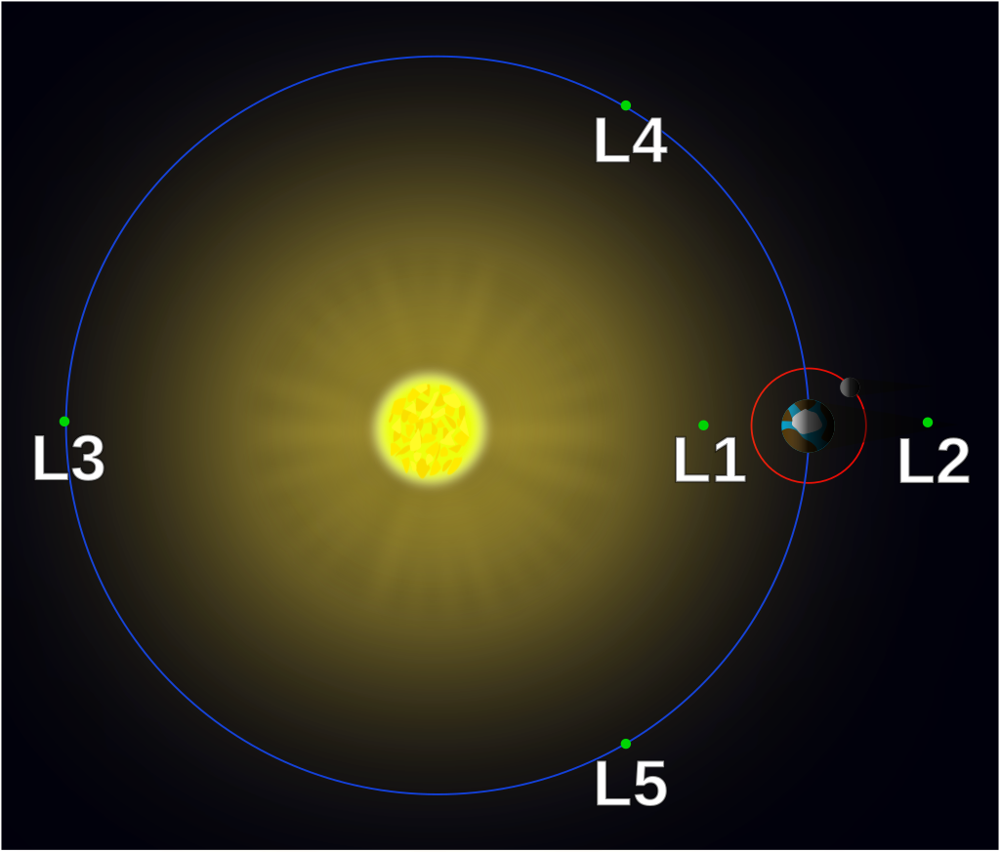

In [15]:
# Show Lagrange points
# Image from wikipedia page for Lagrange Points
from PIL import Image

lpoints = Image.open('lpoints.png')
display(lpoints)

The image above is from [this wikipedia article](https://en.wikipedia.org/wiki/Lagrange_point) on Lagrange Points. The five Lagrange points of the Sun-Earth system are illustrated in the graphic above. The L1, L2, and L3 points all lie on the same line, while L4 and L5 are elsewhere on the trajectory of Earth's orbit and mirror each other.

For this project, I'm going to attempt to model the motion of Lagrange points in a system of mass M (large body) and mass m (smaller body orbiting M), separated by a reasonable distance. Initially, I was going to model the Lagrange points of the Sun-Jupter system, but the numbers required in those calculations proved too much for my laptop to handle.

In [2]:
# Import necessary libraries
# For basic numerical operations
import numpy as np

# For plots
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML
import matplotlib.image as mpimg

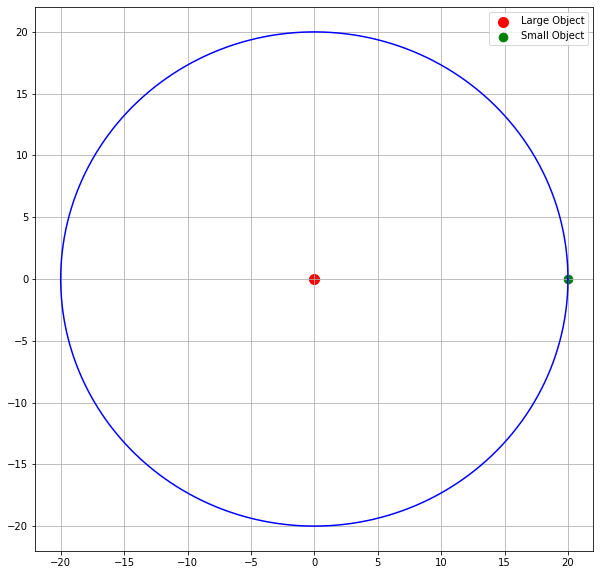

In [3]:
# Illustrate two-body system
theta_pts = np.arange(0, 2 * np.pi, 0.01)

fig, axs = plt.subplots(1, figsize = (10, 10))
plt.scatter(0, 0, color='red', label='Large Object', s=100)  # larger object centered on origin
plt.scatter(20, 0, color='green', label='Small Object', s=75) # smaller object orbiting large object at a distance of 20
plt.plot(20 * np.cos(theta_pts), 20 * np.sin(theta_pts), color='blue')  # path of orbit
plt.legend()
plt.grid()
plt.show()

#### Locate the Lagrange Points

The Lagrangian Equation $L$ is given by $ L = T - U$, where $T$ is the total kinetic energy in the reference frame and $U$ is the effective potential energy in the reference frame. The Euler-Lagrange equation gives

$$
\frac{\partial{L}}{\partial{q}} = \frac{d}{dt} \frac{\partial{L}}{\partial{\dot{q}}}
$$

For any variable $q$ in the Lagrangian. I will use this method to obtain equations of motion, and then solve for the value of $r$ that sets the equation to zero. These zeroes will be the locations of the Lagrange points for the system.

__Locating L1 Lagrange Point:__

This Lagrange point has a calculation that is fairly straightforward. It lies directly between $M$ and $m$, and at such a distance that the mass-distance ratios are equal, and thus any object at this point is in a state of equilibrium.

The kinetic energy of any object at this point is going to be
$$
T = \frac{1}{2}m_{obj}v^{2}
$$

Since I am working with orbits, it would make more sense to calculate the Lagrangian in polar coordinates, making $v^{2}$ now equal to $(\dot{r}^{2} + r^{2}\dot{\theta}^{2})$. I am also going to choose that this orbit is roughly circular, meaning $r$ is unchanging with time, and therefore $\dot{r} = 0$. This brings my $T$ equation to

$$
T = \frac{1}{2}m_{obj}r^{2}\dot{\theta}^{2}
$$

The potential energy acting on an object at the L1 Lagrange point will simply be the difference of the potential from $M$ and the potential from $m$:

$$
U = -\frac{GMm_{obj}}{(R - r)} + \frac{Gmm_{obj}}{r}
$$

Here, $r$ is the distance from the smaller mass $m$ to the L1 Lagrange point. $G$ in this equation is the gravitational constant, and is equal to approximately $6.674 \times 10^{-11}$. However since I am working with an idealized system with no units, I can normalize it (set it equal to 1), and effectively leave this quantity out of my calculations and they will not be affected.

This makes my Lagrangian

$$
L = \frac{1}{2}m_{obj}r^{2}\dot{\theta}^{2} + \frac{GMm_{obj}}{(R - r)} - \frac{Gmm_{obj}}{r}
$$

Taking the derivatives with respect to $\theta$ and $\dot{\theta}$ are not going to help me much, so I will focus on the $r$ equation instead:

$ \frac{\partial{L}}{\partial{r}} = m_{obj}r\dot{\theta}^{2} + \frac{Mm_{obj}}{(R - r)^{2}} - \frac{mm_{obj}}{r^{2}} $

$\frac{\partial{L}}{\partial{\dot{r}}} = 0$

$=> \frac{d}{dt} \frac{\partial{L}}{\partial{\dot{r}}} = 0 $

This gives the equation

$$
m_{obj}r\dot{\theta}^{2} + \frac{Mm_{obj}}{(R - r)^{2}} - \frac{mm_{obj}}{r^{2}} = 0
$$

$m_{obj}$ divides out since it occurs in every term and I am left with

$$
r\dot{\theta}^{2} + \frac{M}{(R - r)^{2}} - \frac{m}{r^{2}}
$$

By Kepler's 3rd law, $\dot{\theta}^{2} = \frac{M + m}{R^{3}}$, so my Euler-Lagrange equation becomes

$$
r\frac{M + m}{R^{3}} + \frac{M}{(R - r)^{2}} - \frac{m}{r^{2}} = 0
$$

Where $r$ is the distance of the L1 Lagrange point from the smaller body, $R$ is the orbital radius of $m$ around $M$, $M$ is the mass of the larger body, and $m$ is the mass of the smaller body.

In [4]:
# Some system parameters
M = 10  # mass of larger, central body
m = 1   # mass of smaller, orbiting body
R = 20  # radius of orbit

In [5]:
# Solve the lagrangian for L1
# my server doesn't have enough precision to get the E-L exactly to zero, but I can get it functionally close enough
def l1_point(M, m, R, r):
    """
    Using Euler-Lagrange equations previously solved for, calculates the net force at some distance r from 
    a celestial body m, orbiting a larger body M, at a distance R
    returns R - r, the location of the L1 lagrange point
    
    Parameters:
        M: mass of central body
        m: mass of orbiting body
        R: radius of orbit of m around M
    """
    theta_dot = np.sqrt((M + m) / R**3)  # Kepler's 3rd law
    F_M = M / (R - r)**2  # potential from M
    F_m = m / r**2  # potential from m
    F_net = (R - r) * theta_dot**2 + F_M - F_m  # E-L equation, returns net force on object at given r
    l_pts = np.abs(F_net)  # absolute value of net force
    l1_idx = [k for k, v in enumerate(l_pts) if v == np.min(l_pts)]  # locate where net force is the smallest
    rl1 = R - r[l1_idx]  # find r at that value, subtract from R to get distance from M
    return rl1

r_pts = np.arange(0.001, 20, 0.001)
rl1 = l1_point(M, m, R, r_pts)
print(rl1, '<-- distance of L1 Lagrange Point from M')

[15.958] <-- distance of L1 Lagrange Point from M


Here I have written a function that computes the value of the Euler-Lagrange equation for the L1 Lagrange point at different points $r$, where $r$ goes from $0 -> R$. My laptop does not have high enough precision to locate the exact numerical value of $r$ in which the EL equation is equal to zero, but it is good enough to locate a minimum on the order of 1e-7 and return $r$ at that point.

__Locating L2 Lagrange Point:__

The L2 Lagrange point lies outside the orbit of $M$ and $m$, and does not orbit $M$, like L1, L4, and L5, but instead orbits the _barycenter_ of the system, the center of mass of $M$ and $m$. As such, this time the potentials from both $M$ and $m$ will be pointed in the same direction, _away_ from the centrifugal term.

$$
T = \frac{1}{2}m_{obj}r^{2}\dot{\theta}^{2}
$$

$$
U = -\frac{Mm_{obj}}{(R + r)} - \frac{mm_{obj}}{r}
$$

$ => L = \frac{1}{2}m_{obj}r^{2}\dot{\theta}^{2} + \frac{Mm_{obj}}{(R + r)} + \frac{mm_{obj}}{r} $

$ \frac{\partial{L}}{\partial{r}} = m_{obj}r\dot{\theta}^{2} - \frac{Mm_{obj}}{(R + r)^{2}} - \frac{mm_{obj}}{r^{2}} $,

$ \frac{\partial{L}}{\partial{\dot{r}}} = 0 $

$$
=> r\dot{\theta}^{2} - \frac{M}{(R + r)^{2}} - \frac{m}{r^{2}} = 0
$$

Again, $r$ is the distance from $m$ to the L2 Lagrange Point.

In [6]:
def l2_point(M, m, R, r):
    """
    Slightly different Euler-Lagrange equation to return the location of the L2 Lagrange point
    
    Parameters:
        M: mass of central body
        m: mass of orbiting body
        R: radius of orbit of m around M
    """
    theta_dot = np.sqrt((M + m) / R**3)
    F_M = M / (R + r)**2
    F_m = m / r**2
    F_net = (R + r) * theta_dot**2 - F_M - F_m
    l_pts = np.abs(F_net)
    l2_idx = [k for k, v in enumerate(l_pts) if v == np.min(l_pts)]
    rl2 = R + r[l2_idx]
    return rl2

r_pts = np.arange(0.001, 20, 0.001)
rl2 = l2_point(M, m, R, r_pts)
print(rl2, '<-- distance of L2 Lagrange point from M')

[26.655] <-- distance of L2 Lagrange point from M


__Locating L3 Lagrange Point:__

The final Lagrange point that lies along only one axis, the L3 Lagrange point is located on the other side of the system from $m$, L1, and L2. This point, like L2, also orbits the barycenter of the system as opposed to $M$. The setup is similar to the equations needed to find L2, but the distances to each mass $M$ and $m$ are a little less intuitive.

$$
T = \frac{1}{2}m_{obj}r^{2}\dot{\theta}^{2}
$$

$$
U = \frac{Mm_{obj}}{(R - r)} + \frac{mm_{obj}}{(2R - r)}
$$

$ => L = \frac{1}{2}m_{obj}r^{2}\dot{\theta}^{2} - \frac{Mm_{obj}}{(R - r)} - \frac{mm_{obj}}{(2R - r)} $

$ \frac{\partial{L}}{\partial{r}} = m_{obj}r\dot{\theta}^{2} - \frac{Mm_{obj}}{(R - r)^{2}} - \frac{mm_{obj}}{(2R - r)^{2}} $

$ \frac{d}{dt} \frac{\partial{L}}{\dot{r}} = 0 $

$$
=> r\dot{\theta}^{2} - \frac{M}{(R - r)^{2}} - \frac{m}{(2R - r)^{2}} = 0
$$

In these equations, the distance from L3 to $M$ is $R - r$, and L3 is inside the orbit of $M$ and $m$.

In [7]:
def l3_point(M, m, R, r):
    """
    Uses the L3 Euler-Lagrange equation to locate the distance of L3 from M
    Parameters:
        M: mass of central body
        m: mass of orbiting body
        R: radius of orbit of m around M
    """
    theta_dot = np.sqrt((M + m) / R**3)
    F_M = M / (R - r)**2
    F_m = m / ((2 * R) - r)**2
    F_net = ((R - r) * theta_dot**2) - F_M - F_m
    l_pts = np.abs(F_net)
    l3_idx = [k for k, v in enumerate(l_pts) if v == np.min(l_pts)]
    rl3 = r[l3_idx] - R
    return rl3

r_pts = np.arange(-5, 10, 0.001)
rl3 = l3_point(M, m, R, r_pts)
print(rl3, '<-- distance of L3 Lagrange point from M')

[-19.531] <-- distance of L3 Lagrange point from M


__Locating L4 and L5 Lagrange Points:__

The calculations behind getting the positions of these two is a bit more complicated, since now a y-component must be incorporated into the calculations. Fortunately, for these two I can exploit _symmetry_, since the governing principles for the L4 and L5 Lagrange points are similar to L1: the net force from $M$ and $m$ at these locations must cancel out. This means that if L4 is located at some angle $\phi$ above the horizontal, then L5 is located at some angle -$\phi$, below the horizontal. It also indicates that they are the same horizontal distance $x$ away from M, and the same magnitude of vertical distance away (L4 located at +y, L5 at -y.

Still, this Lagrangian is not simple.

For this system, I need two values of $r$, $r_{1}$ and $r_{2}$, the distance of the Lagrange point from $M$ and $m$, respectively, with

$$
r_{1}^{2} = x_{1}^{2} + y_{1}^{2}
$$

$$
r_{2}^{2} = x_{2}^{2} + y_{2}^{2}
$$

Fortunately, I can write both expressions using only one set of $(x, y)$ coordinates due to the nature of the system. Since $M$, $m$ lie on the same horizontal plane, the vertical distances from both to the L4 Lagrange point, so $y_{1} = y{2} = y$. The L4 Lagrange point also lies horizontally between $M$ and $m$, so I can say $x_{2} = R - x_{1}$, and I get the equations

$$
r_{1}^{2} = x^{2} + y^{2}
$$

$$
r_{2}^{2} = (R - x)^{2} + y^{2}
$$

Since the L4 and L5 points orbit $M$ with $m$, the $v^{2}$ term should be in terms of $r_{1}$:

$$
T = \frac{1}{2}m_{obj}r_{1}^{2}\dot{\theta}^{2}
$$

The effective potential $U$ now employs two $r$ terms, and includes another potential term from the rotation:

$$
U = \frac{Mm_{obj}}{r_{1}} - \frac{mm_{obj}}{r_{2}} - \frac{1}{2}m_{obj}(r_{1} + r_{2})^{2}
$$

This makes the Lagrangian

$ => L = \frac{1}{2}m_{obj}r_{1}^{2}\dot{\theta}^{2} - \frac{Mm_{obj}}{r_{1}} + \frac{mm_{obj}}{r_{2}} + \frac{1}{2}m_{obj}(r_{1} + r_{2})^{2}$

Solving for $r_{1}$ gives

$ \frac{\partial{L}}{\partial{r_{1}}} = m_{obj}r_{1}\dot{\theta}^{2} + \frac{Mm_{obj}}{r_{1}^{2}} + m_{obj}(r_{1} + r_{2})$,

$ \frac{d}{dt} \frac{\partial{L}}{\partial{\dot{r}}} = 0 $

$ => m_{obj}r_{1}\dot{\theta}^{2} + \frac{Mm_{obj}}{r_{1}^{2}} + m_{obj}(r_{1} + r_{2}) = 0 $

And solving for $r_{2}$ gives

$ \frac{\partial{L}}{\partial{r_{2}}} = -\frac{mm_{obj}}{r_{2}^{2}} + m_{obj}(r_{1} + r_{2}) $

$ \frac{d}{dt} \frac{\partial{L}}{\partial{\dot{r_{2}}}} = 0 $

$ => \frac{mm_{obj}}{r_{2}^{2}} + m_{obj}(r_{1} + r_{2}) = 0 $

Not much to do with these on their own, but I can set them equal to each other and use the previously reasoned values for $x$ and $y$ to solve the system.

$$
m_{obj}r_{1}\dot{\theta}^{2} - \frac{Mm_{obj}}{r_{1}^{2}} + m_{obj}(r_{1} + r_{2}) = -\frac{mm_{obj}}{r_{2}^{2}} + m_{obj}(r_{1} + r_{2})
$$

This simplifies to

$$
r_{1}\dot{\theta}^{2} - \frac{M}{r_{1}^{2}} + \frac{m}{r_{2}^{2}} = 0
$$

In [8]:
def l4_point(r, M, m, R):
    theta_dot = np.sqrt((M + m) / R**3)
    x, y = r
    r1_sq = x**2 + y**2
    r2_sq = (R - x)**2 + y**2
    F_M = M / r1_sq
    F_m = m / r2_sq
    F_net = (np.sqrt(r1_sq) * theta_dot**2) + F_M - F_m
    l_pts = np.abs(F_net)
    l4_idx = np.where(l_pts == np.min(l_pts))
    rl4 = r_pts[0][l4_idx[0]], r_pts[1][l4_idx[1]]
    return rl4

x = np.linspace(0.001, 20, 2000)
y = np.linspace(0.001, 20, 2000)
r_pts = np.meshgrid(x, y)

l4 = l4_point(r_pts, M, m, R)
print(l4)

(array([[1.00000000e-03, 1.10045023e-02, 2.10090045e-02, ...,
        1.99799910e+01, 1.99899955e+01, 2.00000000e+01]]), array([[16.17828014, 16.17828014, 16.17828014, ..., 16.17828014,
        16.17828014, 16.17828014]]))


This is not exactly what I had in mind when I wrote this function, but it seems to have given me at least a y-value for both $r_{1}$ and $r_{2}$, which I can work with.

In [9]:
# Define y-value output above
y = l4[1][0][0]

# Modified l4_point() function, now accepts a y-value argument
def l4_point_with_y(r, M, m, R, y=y):
    theta_dot = np.sqrt((M + m) / R**3)
    r1_sq = (R - r)**2 + y**2
    r2_sq = r**2 + y**2
    E_M = M / r1_sq
    E_m = m / r2_sq
    func = (np.sqrt(r1_sq) * theta_dot**2) - E_M - E_m
    return func

r_pts = np.arange(20-0.001, 0.001, -0.001)
l_pts = np.abs(l4_point_with_y(r_pts, M, m, R))
l4_idx = [k for k, v in enumerate(l_pts) if v == np.min(l_pts)]
print(R - r_pts[l4_idx], '= x')

rl4 = (R - r_pts[l4_idx], y)
rl5 = (R - r_pts[l4_idx], -y)
print(rl4, rl5)

[12.009] = x
(array([12.009]), 16.178280140070033) (array([12.009]), -16.178280140070033)


These are my last two Lagrange points, which means I now have a full system to visualize. And visualize I will.

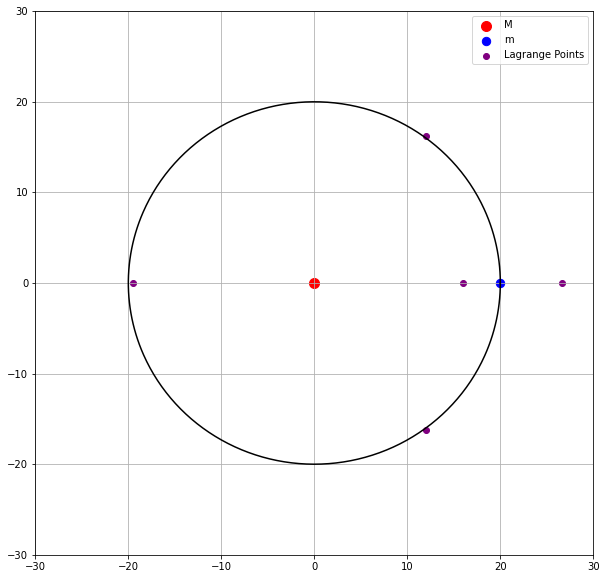

In [10]:
# Plot Lagrange points
fig, axs = plt.subplots(1, figsize = (10, 10))
plt.scatter(0, 0, color='red', label='M', s=100)
plt.scatter(20, 0, color='blue', label='m', s=70)
plt.scatter(rl1, 0, color='purple', label='Lagrange Points')
plt.scatter(rl2, 0, color='purple')
plt.scatter(rl3, 0, color='purple')
plt.scatter(rl4[0], rl4[1], color='purple')
plt.scatter(rl5[0], rl5[1], color='purple')
plt.plot(20 * np.cos(theta_pts), 20 * np.sin(theta_pts), '-k')
plt.legend()
plt.grid()
plt.xlim([-30, 30])
plt.ylim([-30, 30])
plt.show()

Comparing this to the graphic displayed at the beginning of this notebook makes me optimistic with my answers, as the location of the Lagrange points on my plot match the locations of the Lagrange points on the Wikipedia graphic.

__Fun Fact:__ L1, L2, and L3 are *unstable*, so if they are perturbed slightly they will fall out of equilibrium. L4 and L5 are *stable*, and so if perturbed, they will correct and return to their original positions in orbit. Because of the instability of objects at L1, L2, and L3, it is not impossible for chaos to exist in this system. For example, pretend $M$ and $m$ were somewhat close in mass, and $m_{obj}$, located at either the L1, L2, or L3 Lagrange point was sufficiently massive (to the point where its mass cannot be ignored compared to $M$, $m$). In this case, if $m_{obj}$ were disturbed enough, it may fall out of equilibrium and the system would transform from a stable orbit into a kind of general three-body problem. Depending on the masses and configurations of $M$, $m$, and $m_{obj}$, this could begin exhibiting chaos, as three-body systems are usually (or have the potential to be) chaotic with the right characteristics.

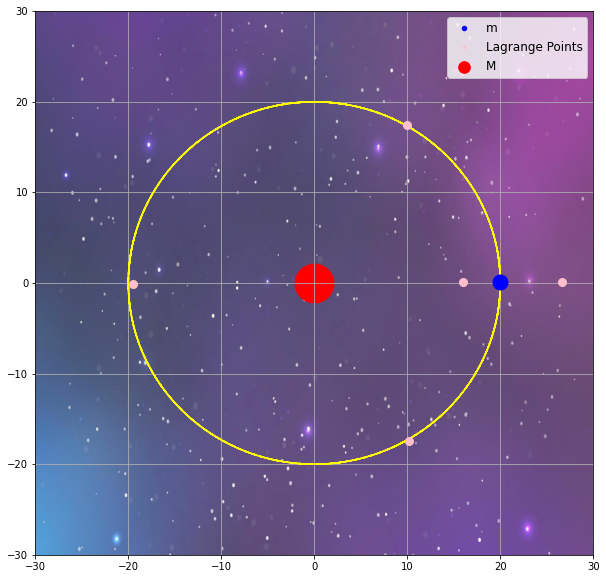

In [13]:
# Animate
# orbit of m
def m_orbit(theta, M, R):
    x_t = R * np.cos(theta)
    y_t = R * np.sin(theta)
    return x_t, y_t

# orbits for L1, L2, L3
def lagrange_orbit1(theta, M, r):
    x_t = r * np.cos(theta)
    y_t = r * np.sin(theta)
    return x_t, y_t

# orbits for L4, L5
def lagrange_orbit2(theta, M, r, phi):
    r_mag = np.sqrt(r[0]**2 + r[1]**2)
    x_t = r_mag * np.cos(theta + phi)
    y_t = r_mag * np.sin(theta + phi)
    return x_t, y_t

theta_pts = np.arange(0, 10 * np.pi+0.01, 0.01)

fig, axs = plt.subplots(1, figsize = (10, 10))
plt.plot(20 * np.cos(theta_pts), 20 * np.sin(theta_pts), color='yellow', linestyle='--')
plt.scatter(0, 0, color='red', label='M', s=1500)
plt.xlim([-30, 30])
plt.ylim([-30, 30])
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)

# Put a space background on the plot because why not
img = mpimg.imread('space_background.jpg')
axs.imshow(img, extent=[-30, 30, -30, 30], aspect='auto', zorder=0, alpha=0.75)

m, = axs.plot([], [], 'ob', markersize=15, label='m')
L1, = axs.plot([], [], 'o', color='pink', markersize = 8, label='Lagrange Points')
L2, = axs.plot([], [], 'o', color='pink', markersize = 8)
L3, = axs.plot([], [], 'o', color='pink', markersize = 8)
L4, = axs.plot([], [], 'o', color='pink', markersize = 8)
L5, = axs.plot([], [], 'o', color='pink', markersize = 8)

def animate(orbit):
    t = theta_pts
    x_m, y_m = m_orbit(t + orbit/20, M, R)
    m.set_data(x_m[-1:], y_m[-1:])
    xl1, yl1 = lagrange_orbit1(t + orbit/20, M, rl1)
    L1.set_data(xl1[-1:], yl1[-1:])
    xl2, yl2 = lagrange_orbit1(t + orbit/20, M, rl2)
    L2.set_data(xl2[-1:], yl2[-1:])
    xl3, yl3 = lagrange_orbit1(t + orbit/20, M, rl3)
    L3.set_data(xl3[-1:], yl3[-1:])
    xl4, yl4 = lagrange_orbit2(t + orbit/20, M, rl4, phi=(np.pi/3))
    L4.set_data(xl4[-1:], yl4[-1:])
    xl5, yl5 = lagrange_orbit2(t + orbit/20, M, rl5, phi=-(np.pi/3))
    L5.set_data(xl5[-1:], yl5[-1:])
    return m, L1, L2, L3, L4, L5

anim = animation.FuncAnimation(fig, animate, frames = 127, interval=15, blit=True)
plt.legend(markerscale = 0.3, fontsize = 'large')
plt.grid()
plt.show()

In [14]:
plt.rcParams['animation.embed_limit'] = 2**(64)
HTML(anim.to_jshtml())